# Entendiendo el formato de los datos single-cell

El comienzo de este notebook contiene la primera toma de contacto con librerías como Scanpy, AnnData, scipy... típicas del estudio single-cell en python. Pruebo qué es un objeto AnnData, distintas formas de representarlos de forma visual, que informació recoge y cómo la divide... Todo ello será necesario para, primero, comprender el trabajo a realizar y, segundo, poder realizar las comparativas entre distintos modelos de forma posterior.

En la segunda parte del notebook se muestra todo el proceso de visualización de los conjuntos de datos de esclerosis múltiple y páncreas usados de forma posterior en la tarea de anotación de tipos celulares. Durante esta, he tratado de ir detallando de forma precisa mi intención con cada una de las gráficas y las conclusiones/conocimiento que puedo obtener de cada una.

In [1]:
import scanpy as sc

adata_pancreas = sc.read_h5ad("/Users/doblado/Transformers-Architecture-in-Bioinformatics/Datasets/single-cell/human_pancreas_norm_complexBatch.h5ad")


In [ ]:
# Celda para leer datasets en formato .h5ad, devuelve objetos AnnData
# Para visualizar recomiendo usar el formato DataFrame
import scanpy as sc
import pandas as pd
from scipy.sparse import csr_matrix


#En var sólo se almacenan, en este caso, los nombres de los genes
adata_pancreas.var_names

# Convertimos a matriz dispersa para visualizar mejor
#adata_pancreas.X
adata_pancreas.X = csr_matrix(adata_pancreas.X)

adata_df = pd.DataFrame(adata_pancreas.X.toarray(), index=adata_pancreas.obs_names, columns=adata_pancreas.var_names)
#adata_df.head()


# Valores de expresión entre células y genes
# Los valores pueden ir desde 0 hasta valores como 5575.82
#adata_pancreas.layers["counts"].max(axis=0)

array([ 468.  , 1637.  , 5575.82, ..., 2436.  , 1723.72,  515.  ],
      dtype=float32)

In [31]:
#Podemos sacar los índices a una columna en sí
gene_col = "Gene Symbol"
adata_pancreas.var[gene_col] = adata_pancreas.var.index.values
adata_pancreas.var



,Gene Symbol
A1BG,A1BG
A1CF,A1CF
A2M,A2M
A2ML1,A2ML1
A4GALT,A4GALT
...,...
ZXDC,ZXDC
ZYG11B,ZYG11B
ZYX,ZYX
ZZEF1,ZZEF1


In [32]:
adata_pancreas_copy = adata_pancreas.copy()

In [ ]:
#Selection of highly variable genes
N_HVG = 1800 

# Pre-procesamiento
sc.pp.normalize_total(adata_pancreas, target_sum=1e4)
sc.pp.log1p(adata_pancreas)

#highly variable genes
sc.pp.highly_variable_genes(adata_pancreas, n_top_genes=N_HVG, flavor="seurat_v3")
# Cuando hacemos subsetting, tenemos primero obs y después var
adata_pancreas = adata_pancreas[:, adata_pancreas.var['highly_variable']]


/Users/doblado/miniforge3/envs/envTFG/lib/python3.12/site-packages/scanpy/preprocessing/_highly_variable_genes.py:75: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(
OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


In [ ]:
# Observamos todos los cambios generados en los datos
print(adata_pancreas)

# ¿Todos son áltamente variables?
#boolean_s = adata_pancreas[:,adata_pancreas.var["highly_variable"] == False] # Es un booleano
#print(boolean_s.var)

adata_pancreas.obs
adata_df2 = pd.DataFrame(adata_pancreas.X.toarray(), index=adata_pancreas.obs_names, columns=adata_pancreas.var_names)

print("----- Highly Variable -----")
#print(adata_df2.head(10))
adata_df2.sort_index(axis=1,level=0)
# Si comparamos con la celda de abajo, vemos que los genes no son los mismos
# tras las transformaciones
#adata_df2["A1BG"]

View of AnnData object with n_obs × n_vars = 16382 × 1800
    obs: 'tech', 'celltype', 'size_factors'
    var: 'Gene Symbol', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'log1p', 'hvg'
    layers: 'counts'
----- Highly Variable -----


View of AnnData object with n_obs × n_vars = 16382 × 1800
    obs: 'tech', 'celltype', 'size_factors'
    var: 'Gene Symbol', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'log1p', 'hvg'
    layers: 'counts'

In [45]:
# Quiero comparar ámbos, quería ver que efectivamente muestran distintos genes
# Tras comprobarlos, voy a ordenarlos para visualizar lo mismo
print("----- Raw Data -----")
#print(adata_df.head(5))
adata_df.sort_index(axis=1,level=0)
adata_df["A1BG"]

----- Raw Data -----


D101_5         0.000000
D101_43        2.612081
D101_93        0.000000
D102_4         3.091586
D172444_23     0.000000
                 ...   
Sample_1594    0.000000
Sample_1595    2.213732
Sample_1597    0.429963
Sample_1598    3.469557
Sample_1600    0.456665
Name: A1BG, Length: 16382, dtype: float32

A continuación, tenemos dos mapas de calor que muestran los niveles de expresión de distintos genes en distintas células. Me parece una herramienta bastante interesante, más a nivel visual que a nivel de interpretabilidad práctica, ya que no puedes comparar demasiados valores. 

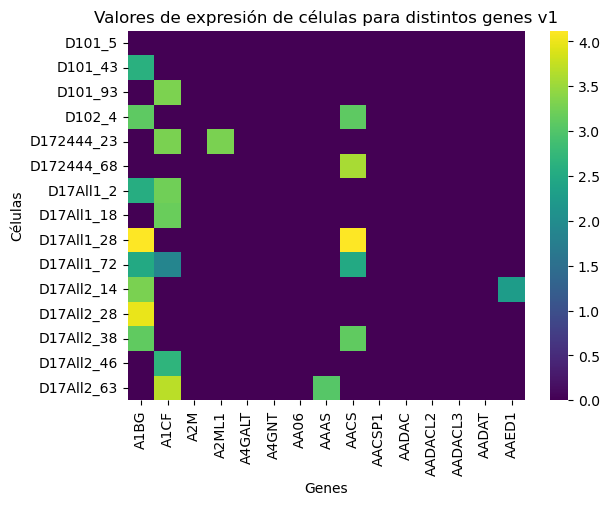

In [49]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.heatmap(adata_df.iloc[:15, :15], cmap="viridis")
plt.title("Valores de expresión de células para distintos genes v1")
plt.ylabel("Células")
plt.xlabel("Genes")
plt.show()

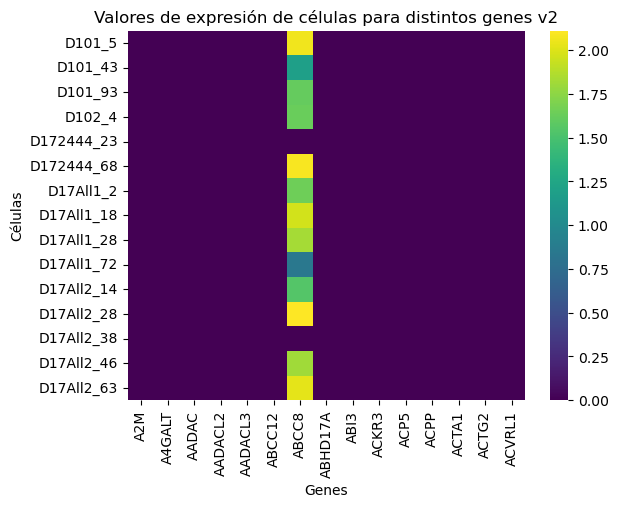

In [48]:
#Podemos observar como sí ha cambiado bastante la representación
sns.heatmap(adata_df2.iloc[:15, :15], cmap="viridis")
plt.title("Valores de expresión de células para distintos genes v2")
plt.ylabel("Células")
plt.xlabel("Genes")
plt.show()

# DATASET ESCLEROSIS MÚLTIPLE

Pasamos a analizar el dataset de esclerosis múltiple, usado en scGPT para la tarea de cell type annotation

In [122]:
from matplotlib.pyplot import rc_context
import scanpy as sc
import anndata as ad
import pandas as pd

import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import plotly.express as px




In [123]:

adata_sclerosis = sc.read_h5ad("/Users/doblado/Transformers-Architecture-in-Bioinformatics/Experimentacion/data/ms/esclerosis_scGPT_data.h5ad")
adata_sclerosis_enfermos = sc.read_h5ad("/Users/doblado/Transformers-Architecture-in-Bioinformatics/Experimentacion/data/ms/filtered_ms_adata.h5ad")

metadata_df_control = adata_sclerosis.obs
metadata_df_enfermos = adata_sclerosis_enfermos.obs


In [124]:
adata_sclerosis

AnnData object with n_obs × n_vars = 7844 × 3000
    obs: 'Sample Characteristic[organism]', 'Sample Characteristic Ontology Term[organism]', 'Sample Characteristic[individual]', 'Sample Characteristic Ontology Term[individual]', 'Sample Characteristic[sex]', 'Sample Characteristic Ontology Term[sex]', 'Sample Characteristic[age]', 'Sample Characteristic Ontology Term[age]', 'Sample Characteristic[developmental stage]', 'Sample Characteristic Ontology Term[developmental stage]', 'Sample Characteristic[organism part]', 'Sample Characteristic Ontology Term[organism part]', 'Sample Characteristic[sampling site]', 'Sample Characteristic Ontology Term[sampling site]', 'Sample Characteristic[disease]', 'Sample Characteristic Ontology Term[disease]', 'Sample Characteristic[organism status]', 'Sample Characteristic Ontology Term[organism status]', 'Sample Characteristic[cause of death]', 'Sample Characteristic Ontology Term[cause of death]', 'Sample Characteristic[clinical history]', 'Sample C

# Visualización de metadatos

La distribución de tipos celulares es un aspecto clave a la hora de evaluar el rendimiento de los modelos. Comprobamos cómo para aquellos tipos celulares apenas presentes en los conjuntos de datos: Fagocitos, Oligodendrocitos C, etc; los modelos obtienen un resultado notablemente menor que para tipos celulares más presentes como las células neuronales.

En los siguientes dos gráficos se muestra esta distribución. Podemos observar como las proporciones se mantienen entre conjuntos de datos, simplemente que el dataset de test(enfermos) tiene mayor cantidad de células.

In [ ]:
cell_counts = metadata_df_control['celltype'].value_counts().reset_index()
cell_counts.columns = ['celltype', 'count']

fig = px.scatter(cell_counts, x = "celltype", y = "count", color="celltype",
                 size = 'count',
                 hover_name="celltype", title = 'Distribución de tipos celulares MS control')
fig.show()

In [27]:
cell_counts = metadata_df_enfermos['celltype'].value_counts().reset_index()
cell_counts.columns = ['celltype', 'count']

fig = px.scatter(cell_counts, x = "celltype", y = "count", color="celltype",
                 size = 'count',
                 hover_name="celltype", title = 'Distribución de tipos celulares MS enfermos')
fig.show()

Observando esta distribución en función de los individuos de los que se han muestreado las células, no observamos ningún patrón común demasiado destacado. Aun así, es cierto que los tipos celulares mayoritarios suelen concentrarse en un número reducido de individuos, sobre todo en el dataset de control(C8-C3).

Text(0.5, 1.0, 'Distribución de tipos celulares por individuos de control')

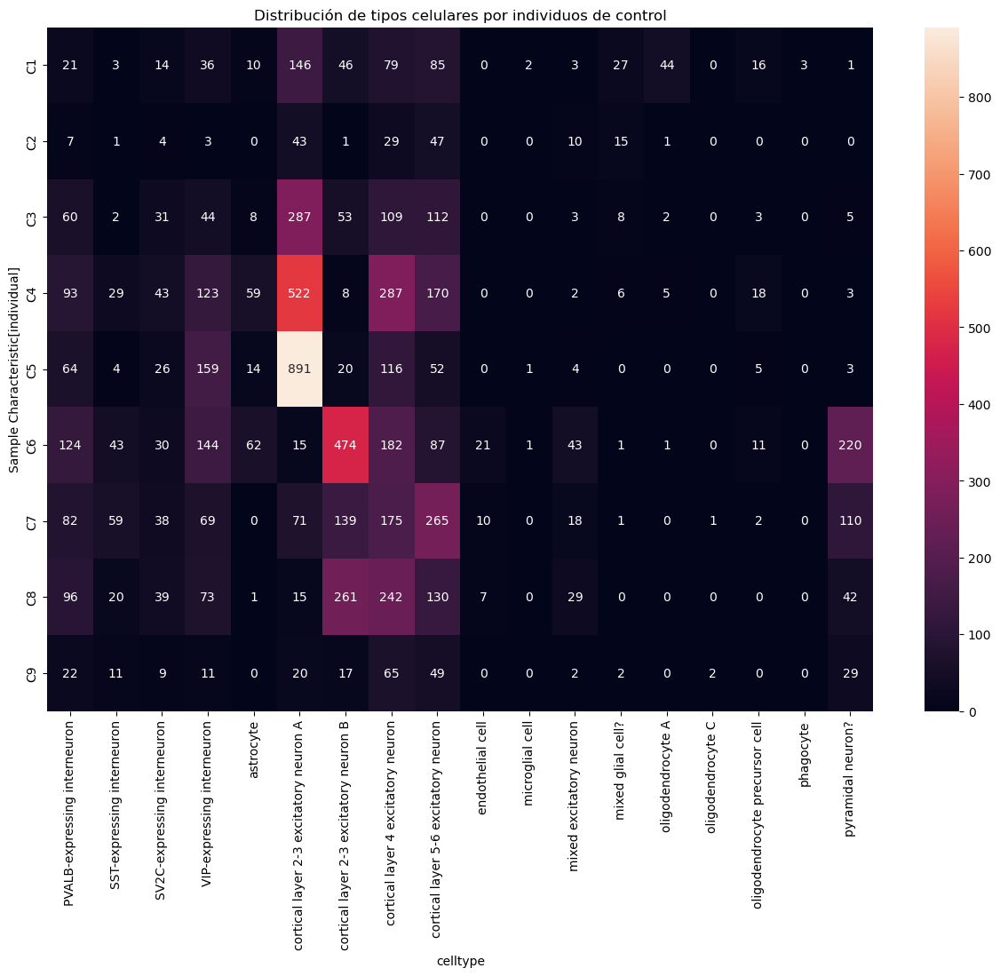

In [37]:
tabla_contingencia = pd.crosstab(metadata_df_control['Sample Characteristic[individual]'], metadata_df_control['celltype'])

plt.figure(figsize=(15,10))
sns.heatmap(tabla_contingencia, annot = True, fmt = 'g')
plt.title("Distribución de tipos celulares por individuos de control")  

Text(0.5, 1.0, 'Distribución de tipos celulares por individuos enfermos')

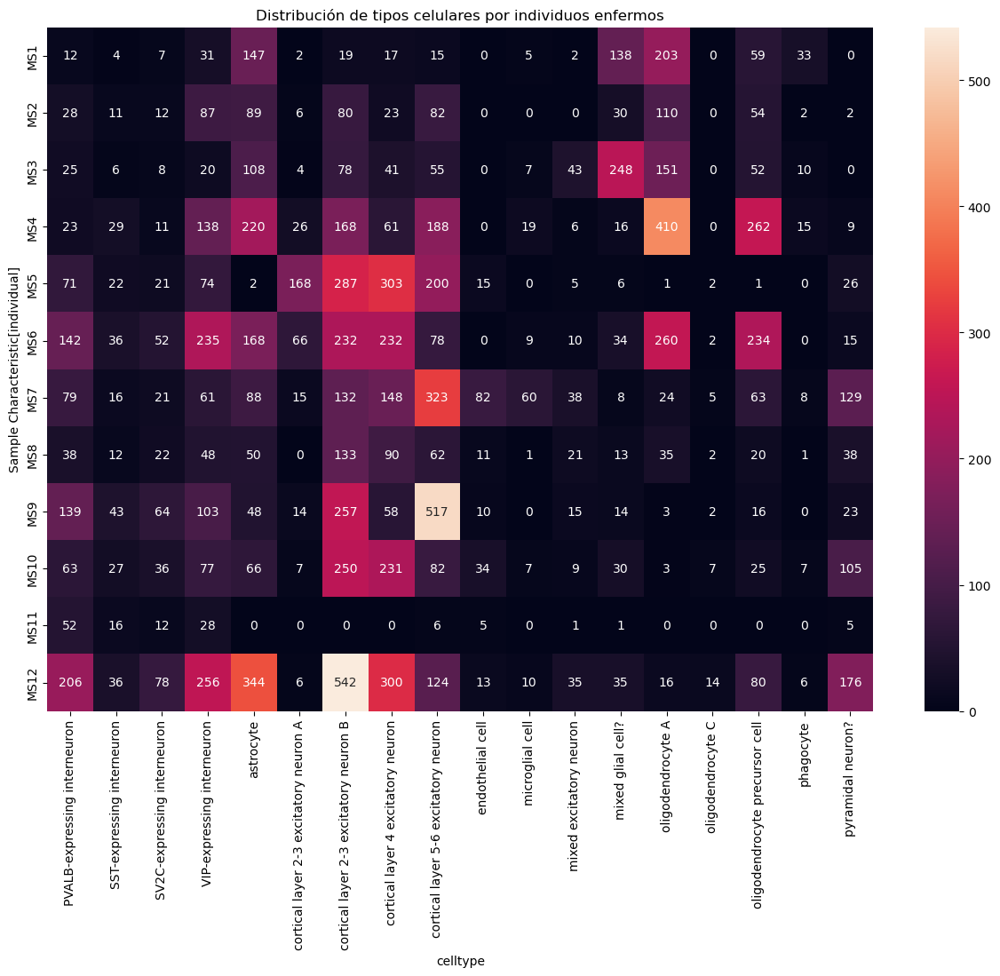

In [38]:
tabla_contingencia = pd.crosstab(metadata_df_enfermos['Sample Characteristic[individual]'], metadata_df_enfermos['celltype'])

plt.figure(figsize=(15,10))
sns.heatmap(tabla_contingencia, annot = True, fmt = 'g') 
plt.title("Distribución de tipos celulares por individuos enfermos")  

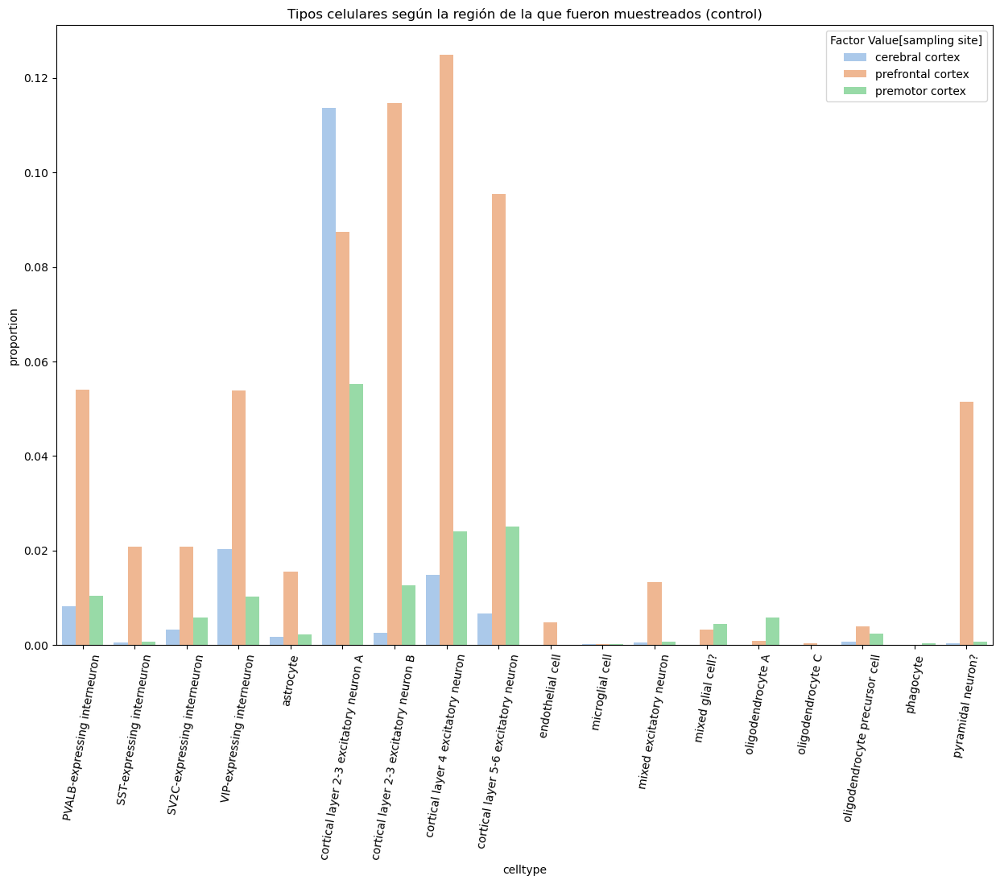

In [43]:
plt.figure(figsize=(15,10))
sns.countplot(metadata_df_control, x = 'celltype', hue = 'Factor Value[sampling site]', palette='pastel', stat='proportion')
plt.xticks(rotation=80)
plt.title("Tipos celulares según la región de la que fueron muestreados (control)")
plt.show()

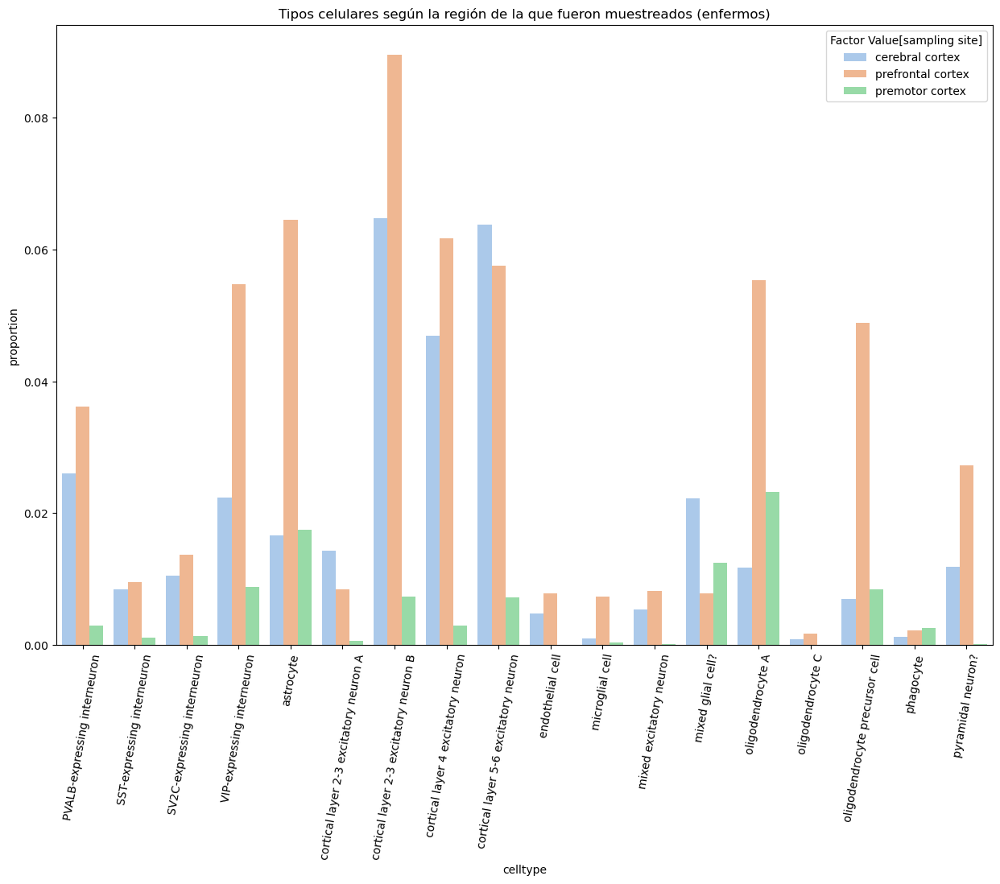

In [44]:
plt.figure(figsize=(15,10))
sns.countplot(metadata_df_enfermos, x = 'celltype', hue = 'Factor Value[sampling site]', palette='pastel', stat='proportion')
plt.xticks(rotation=80)
plt.title("Tipos celulares según la región de la que fueron muestreados (enfermos)")
plt.show()

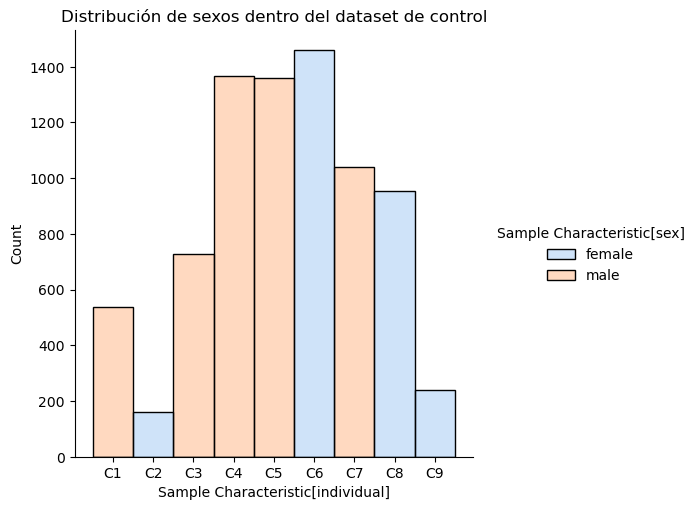

In [ ]:
sns.displot(metadata_df_control, x = 'Sample Characteristic[individual]', hue = 'Sample Characteristic[sex]', palette= 'pastel')
plt.title("Distribución de sexos dentro del dataset de control")

<Figure size 500x1500 with 0 Axes>

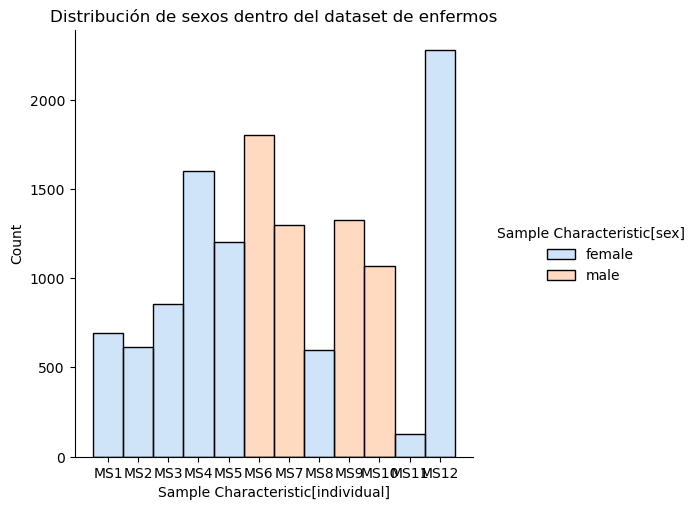

In [ ]:
plt.figure(figsize=(5,15))
sns.displot(metadata_df_enfermos, x = 'Sample Characteristic[individual]', hue = 'Sample Characteristic[sex]', palette= 'pastel')
plt.title("Distribución de sexos dentro del dataset de enfermos")

# Visualización Bioinformática

In [53]:
#df_control = pd.DataFrame(adata_sclerosis.X.toarray(), index=adata_sclerosis.obs_names, columns=adata_sclerosis.var_names)
#df_control.describe()


Por motivos de dimensionalidad de los datos single-cell RNA-seq, para realizar algunos gráficos vamos a quedarnos símplemente o bien con una serie de genes identificados como factores de transcripción o bien con una muestra del total de los genes ordenados por su rango de variabilidad en cuanto al perfil transcriptómico.

La medición de esta variabilidad es facilmente realizable gracias a la librería scanpy. En el caso de el dataset de esclerosis múltiple, esta información ya viene almacenada como metadatos en el dataset de control. Simplemente tendremos que aplicarlo en el dataset de pacientes enfermos para que nos devuelva estos genes ordenados en función de sus niveles de expresión.

In [34]:
adata_sclerosis.var['sorted_hvg'] = sorted(adata_sclerosis.var['highly_variable_rank'], reverse=True)


sc.pp.highly_variable_genes(adata_sclerosis_enfermos, n_top_genes=3000, inplace = True, flavor = 'seurat_v3')
adata_sclerosis_enfermos.var = adata_sclerosis_enfermos.var.set_index('gene_name')
adata_sclerosis_enfermos.var['gene_name'] = adata_sclerosis.var['gene_name']
adata_sclerosis_enfermos.var['sorted_hvg'] = sorted(adata_sclerosis_enfermos.var['highly_variable_rank'], reverse=True)
#adata_sclerosis_enfermos.var.loc['ST18']

/Users/doblado/miniforge3/envs/envTFG/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:75: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(
/Users/doblado/miniforge3/envs/envTFG/lib/python3.10/site-packages/anndata/_core/anndata.py:750: UserWarning: 
AnnData expects .var.index to contain strings, but got values like:
    ['CFH', 'BAD', 'LAP3', 'CD99', 'WNT16']

    Inferred to be: categorical

  value_idx = self._prep_dim_index(value.index, attr)


Para la visualización de los datos single-cell tenemos muchas opciones. Antes que nada, añadiremos al conjunto de datos de control información de reducción de dimensionalidad aplicando un PCA, calcularemos la vecindad de las células en base a este y, por último, incrustaremos esta vecindad en un espacio de baja dimensionalidad con UMAP. Durante los siguientes gráficos, iremos usando esta información en función de las necesidades de las representaciones.

In [ ]:
# Dataset de control
count_instances = ad.AnnData(X = adata_sclerosis.X.toarray())
sc.tl.pca(count_instances)
adata_sclerosis.obsm["X_pca"] = count_instances.obsm['X_pca']
adata_sclerosis.uns["pca"] = count_instances.uns['pca']
adata_sclerosis.varm['PCs'] = count_instances.varm['PCs']

sc.pp.neighbors(count_instances, use_rep="X")
sc.tl.umap(count_instances, random_state = 0)

adata_sclerosis.obsm["X_umap"] = count_instances.obsm["X_umap"]
adata_sclerosis.uns["neighbors"] = count_instances.uns['neighbors']
adata_sclerosis.uns["umap"] = count_instances.uns['umap']
adata_sclerosis.obsp["distances"] = count_instances.obsp['distances']
adata_sclerosis.obsp["connectivities"] = count_instances.obsp['connectivities']

# Dataset Enfermos
count_instances_enfermos = ad.AnnData(X = adata_sclerosis_enfermos.X.toarray())
sc.tl.pca(count_instances_enfermos)
adata_sclerosis_enfermos.varm['PCs'] = count_instances_enfermos.varm['PCs']
adata_sclerosis_enfermos.uns["pca"] = count_instances_enfermos.uns['pca']
adata_sclerosis_enfermos.obsm["X_pca"] = count_instances_enfermos.obsm['X_pca']


Al consultar la información relacionada con el estudio originario del que fueron extraído estos datos de esclerosis múltiple, hemos extraído el siguiente conjunto de genes identificados como factores de transcripción:

- AQP4: Marcador de Astrocitos
- GFAP: Marcador de Gliosis
- ST18: Factor de transcripción de oligodendrocitos
- FTL: Marcador de reactividad de la microglía
- PLP1: Marcador de células fagocitarias

En los siguientes gráficos, trataremos de estudiar si encontramos patrones destacados en algunos de estos genes, además de estudiar también a los genes con mayor variabilidad en cuanto a su expresión génica.

In [36]:
sc.set_figure_params(dpi=100, color_map="viridis_r")
sc.settings.verbosity = 0

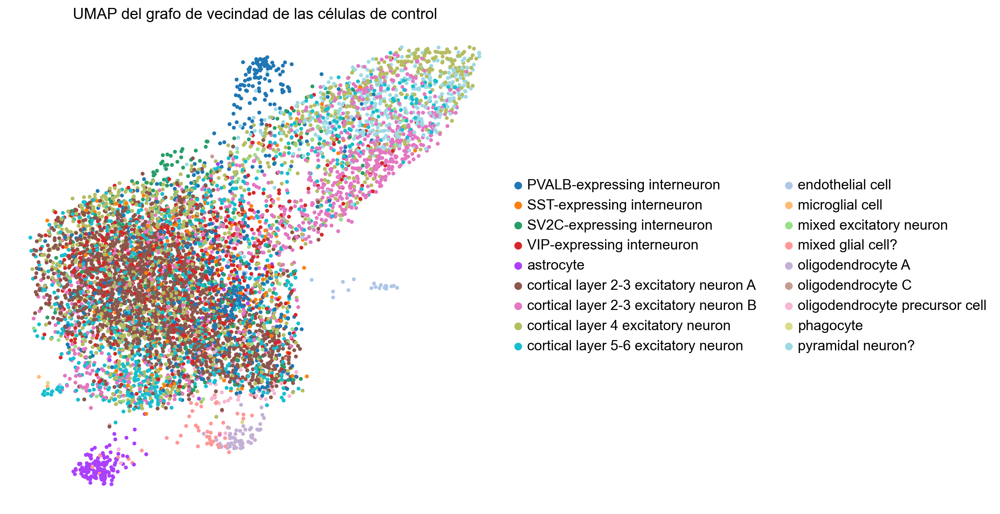

In [37]:
with rc_context({"figure.figsize": (8, 8 )}):
    sc.pl.umap(adata_sclerosis, color='celltype', s=50, frameon=False, vmax="p99", title = "UMAP del grafo de vecindad de las células de control")

Comparando la expresión de cada uno de los genes con la expresión de tipos celulares en general, podemos apreciar ciertas consideraciones. 

En primer lugar, la visualización general de todos los tipos celulares no nos aporta demasiada información, con la mayoría de los tipos mezclados y con solo algunos tipos como los Astrocitos o muestras de inter-neuronas de expresión PVALB bien diferenciados. En segundo lugar, al visualizar los distintos marcadores genéticos observamos como AQP4, marcador de astrocitos, se encuentra áltamente expresado dentro de los mismos. Lo mismo ocurre con GFAP, indicador de gliosis (la gliosis está relacionada con una sobre-producción de astrocitos). ST18 también coincide con la expresión de oligodendrocitos, en concreto con los tipo A. La expresión de PLP1 parece indicar que estos mismos tienen una función fagocitaria, aunque en principio a nivel teórico son células estructurales. Por el contrario, la expresión de FTL no es nada específica ni muestra un patrón concreto(es el gen con mayor variabilidad de los mostrados). 

En cuanto al análisis de los datos de pacientes enfermos, la diferenciación general de los tipos celulares es mucho mayor. En cuanto a los marcadores genéticos, nos encontramos con resultados muy similares a los obtenidos para el conjunto de datos de pacientes de control, con una mejor diferenciación para FTL. Este, se encuentra altamente expresado en células microgliales y endoteliales.

Introducimos también un gen aleatorio, GSTT1, por si encontrábamos algún patrón significativo y no observamos nada diferencial.

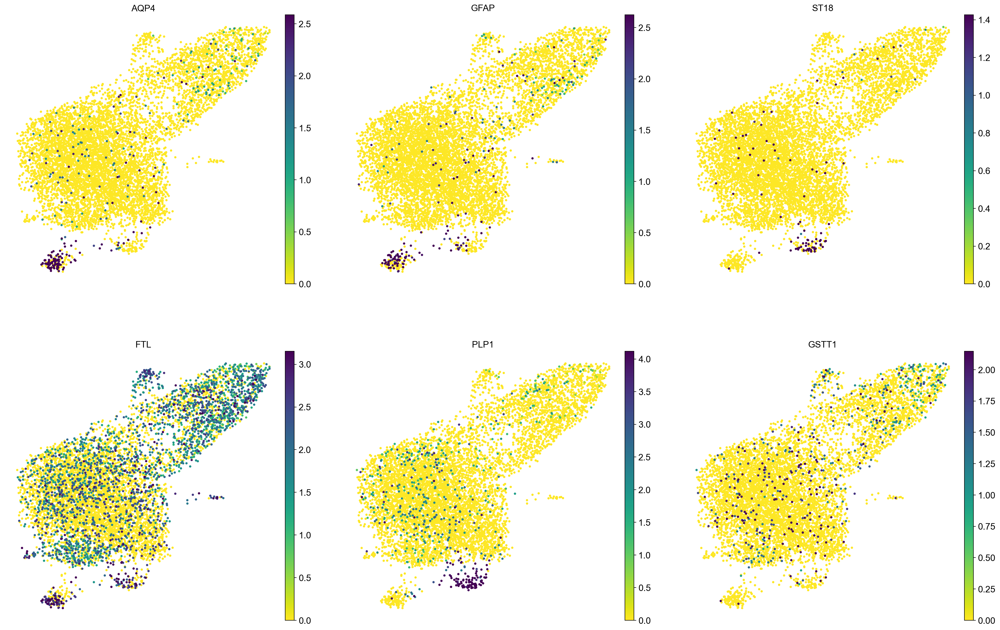

In [38]:
color_vars = [
    "AQP4",
    "GFAP",
    "ST18",
    "FTL",
    "PLP1",
    "GSTT1",	
    
]

with rc_context({"figure.figsize": (8, 8)}):
    sc.pl.umap(adata_sclerosis, color=color_vars, s=50, frameon=False, ncols=3, vmax="p99")

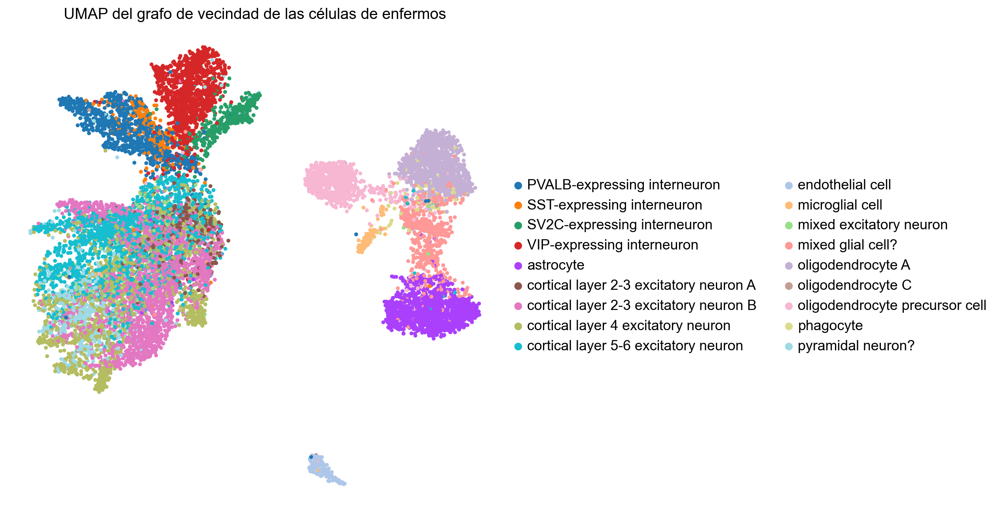

In [39]:
with rc_context({"figure.figsize": (8, 8 )}):
    sc.pl.umap(adata_sclerosis_enfermos, color='celltype', s=50, frameon=False, vmax="p99", title = "UMAP del grafo de vecindad de las células de enfermos")

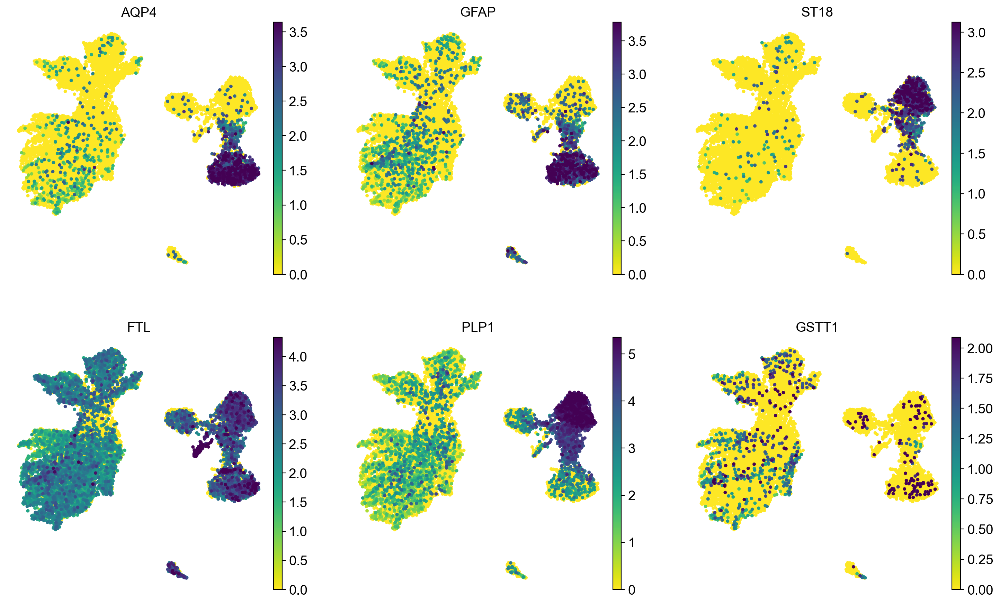

In [40]:
color_vars = [
    "AQP4",
    "GFAP",
    "ST18",
    "FTL",
    "PLP1",
    "GSTT1",	
    
]

with rc_context({"figure.figsize": (5, 5)}):
    sc.pl.umap(adata_sclerosis_enfermos, color=color_vars, s=50, frameon=False, ncols=3, vmax="p99")

A continuación, por medio de el método Leiden, realizaremos un clustering de nuestras células. Esto nos permitirá, además de diferenciarlas de forma no-supervisada en base a criterios previamente desconocidos, realizar una serie de gráficos muy interesantes en base a estos clusters. Para el clustering usamos los parámetros resolution = 0.5 y n_iterations = -1, que realiza iteraciones hasta que el algoritmo alcanza un máximo.

Observando el resultado de estos clustering usando la misma visualización UMAP anterior, vemos que para los datos de control el número de clusters es mucho menor a los tipos celulares, mientras que para los datos de pacientes enfermos la equivalencia es más acorde.

In [41]:
sc.tl.leiden(
    adata_sclerosis,
    key_added="clusters",
    resolution=0.5,
    n_iterations=-1,
    flavor="igraph",
    directed=False,
)

In [42]:
sc.tl.leiden(
    adata_sclerosis_enfermos,
    key_added="clusters",
    resolution=0.5,
    n_iterations=-1,
    flavor="igraph",
    directed=False,
)

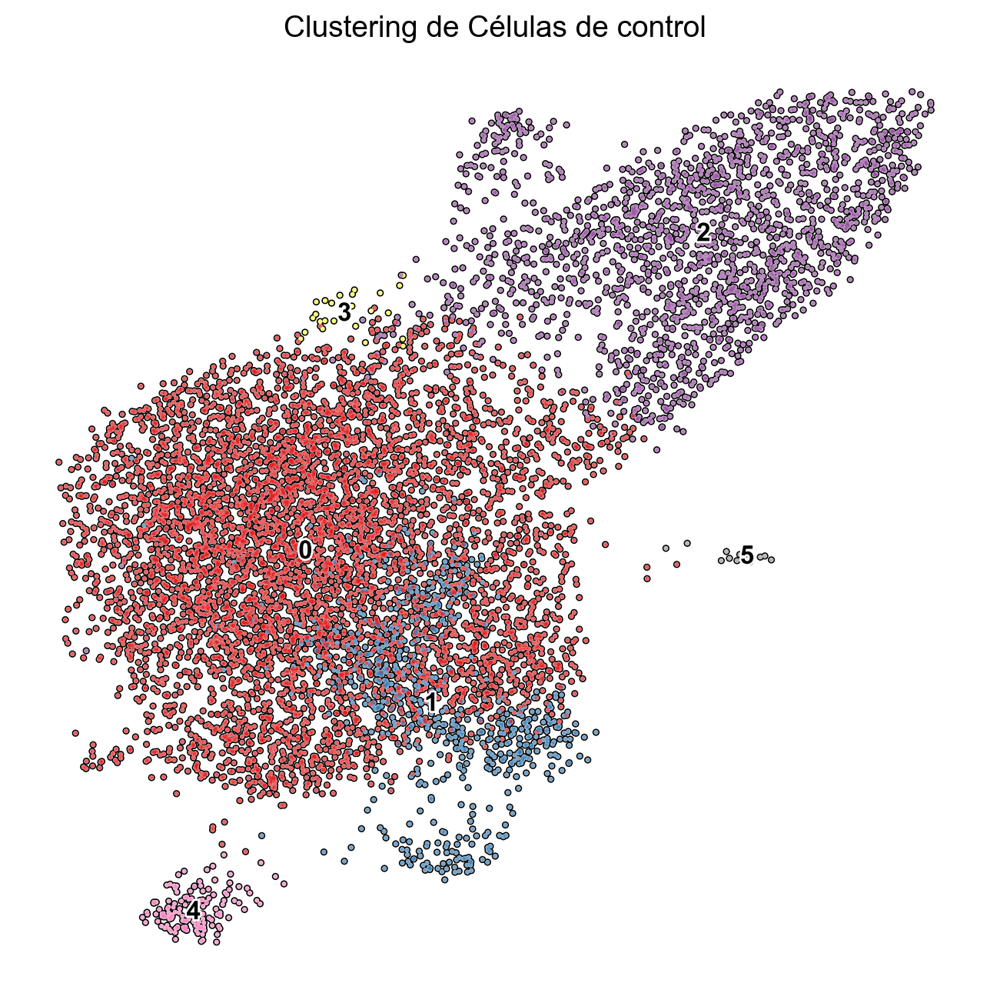

In [43]:
with rc_context({"figure.figsize": (8, 8)}):
    sc.pl.umap(
        adata_sclerosis,
        color="clusters",
        add_outline=True,
        legend_loc="on data",
        legend_fontsize=12,
        legend_fontoutline=2,
        frameon=False,
        title="Clustering de Células de control",
        palette="Set1",
    )

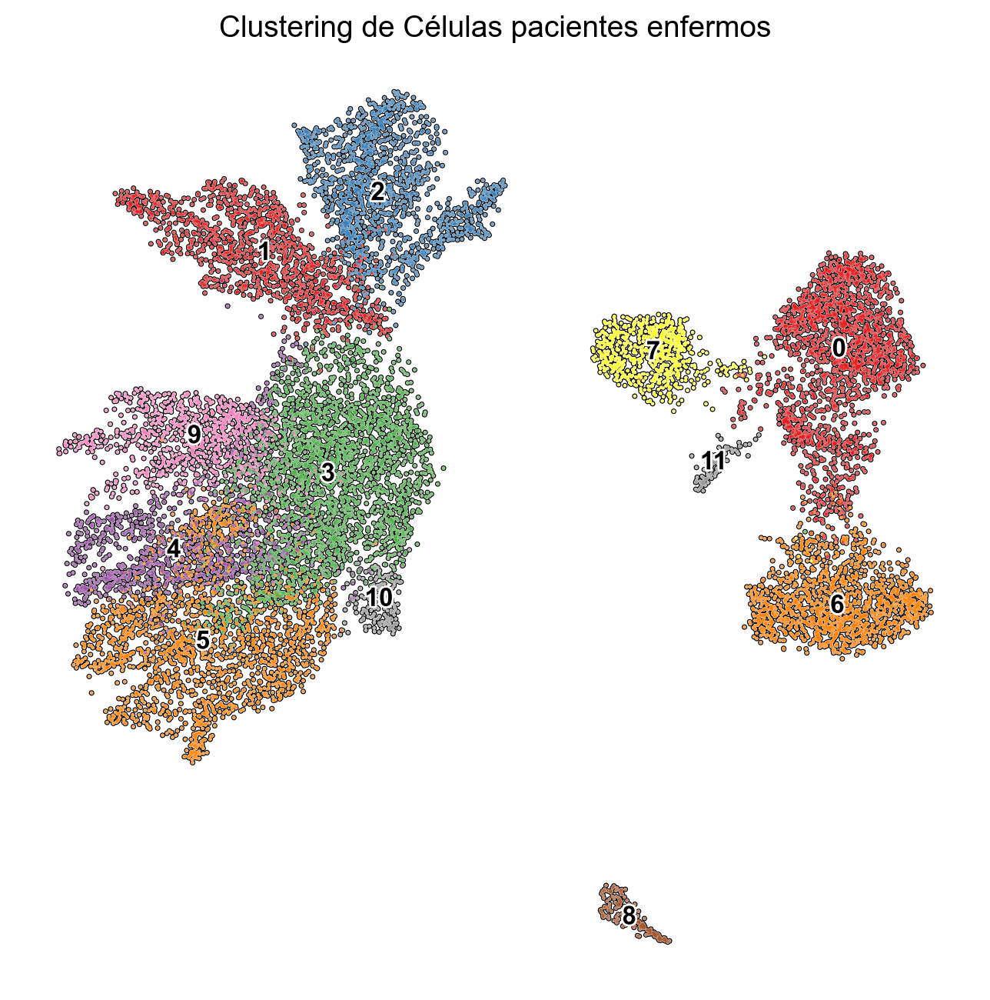

In [89]:
with rc_context({"figure.figsize": (8, 8)}):
    sc.pl.umap(
        adata_sclerosis_enfermos,
        color="clusters",
        add_outline=True,
        legend_loc="on data",
        legend_fontsize=12,
        legend_fontoutline=2,
        frameon=False,
        title="Clustering de Células pacientes enfermos",
        palette="Set1",
    )

Haciendo uso de estos clusters, podemos ver dentro de cuales se encuentran más expresados nuestros factores de transcripción. Estos diagramas de violín son otra forma de obtener las mismas conclusiones que obtuvimos con la visualización del UMAP, en el caso de que un tipo celular coincida de forma muy marcada con un cluster. Esto ocurre, por ejemplo, para el gen AQP4 y los astrocitos en el dataset de control.

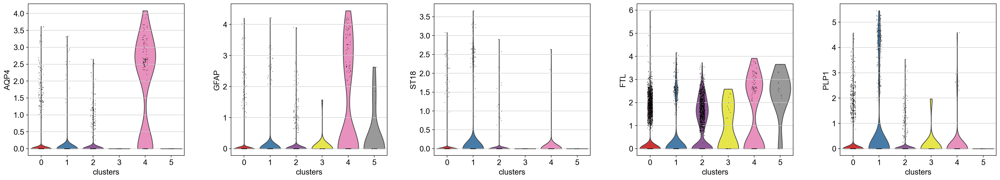

In [ ]:
with rc_context({"figure.figsize": (8, 8)}):
    sc.pl.violin(adata_sclerosis, ["AQP4","GFAP","ST18","FTL","PLP1"], groupby="clusters")

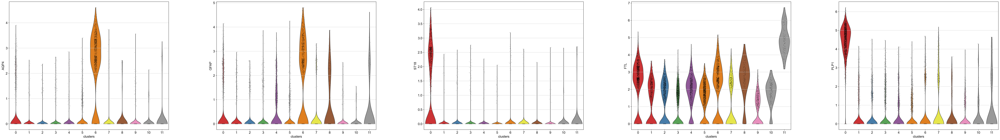

In [46]:
with rc_context({"figure.figsize": (10, 10)}):
    sc.pl.violin(adata_sclerosis_enfermos, ["AQP4","GFAP","ST18","FTL","PLP1"], groupby="clusters")

También podemos ver la distribución dentro de estos clusters de los individuos, tanto distinguiéndolos entre sí como en función de sus edades. En este caso, al ser una muestra tan pequeña las conclusiones que podemos visualizar se reducen a ver de qué paciente se ha extraído mayoritariamente un determinado cluster.

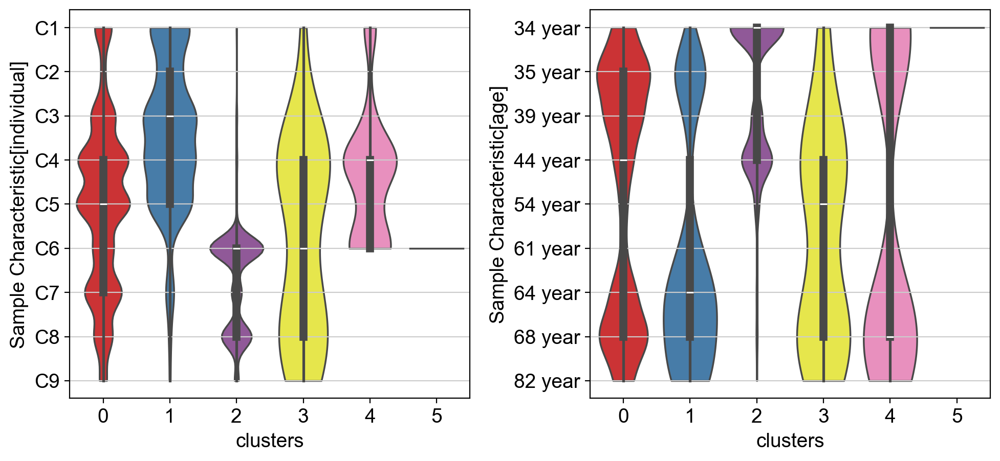

In [ ]:
with rc_context({"figure.figsize": (5, 5)}):
    sc.pl.violin(
        adata_sclerosis,
        ["Sample Characteristic[individual]", "Sample Characteristic[age]"],
        groupby="clusters",
        stripplot=False,  # remove the internal dots
        inner="box",  # adds a boxplot inside violins
    )

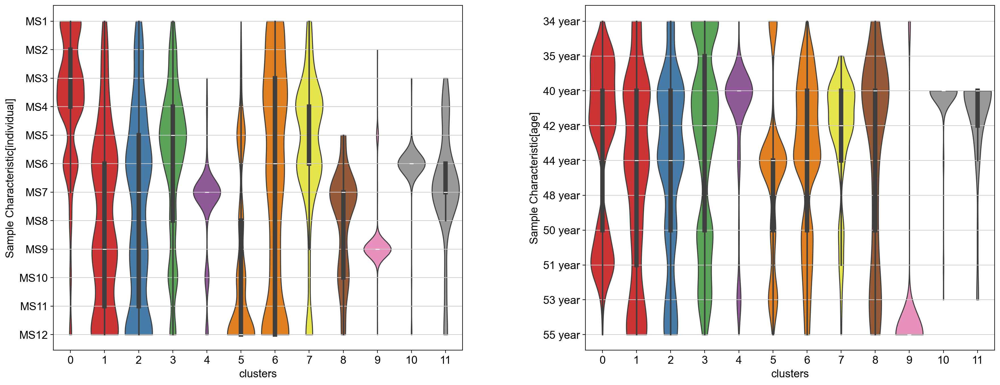

In [ ]:
with rc_context({"figure.figsize": (8, 8)}):
    sc.pl.violin(
        adata_sclerosis_enfermos,
        ["Sample Characteristic[individual]", "Sample Characteristic[age]"],
        groupby="clusters",
        stripplot=False,  
        inner="box",  
    )

También resulta interesante estudiar los n genes más expresados dentro de cada cluster, con el número de células en la que se encuentran expresados dentro de los mismos. Esta visualización, para clústeres muy marcados por un tipo celular concreto, junto con conocimiento experto nos puede llevar a descubrir factores de transcripción dentro de un dataset.

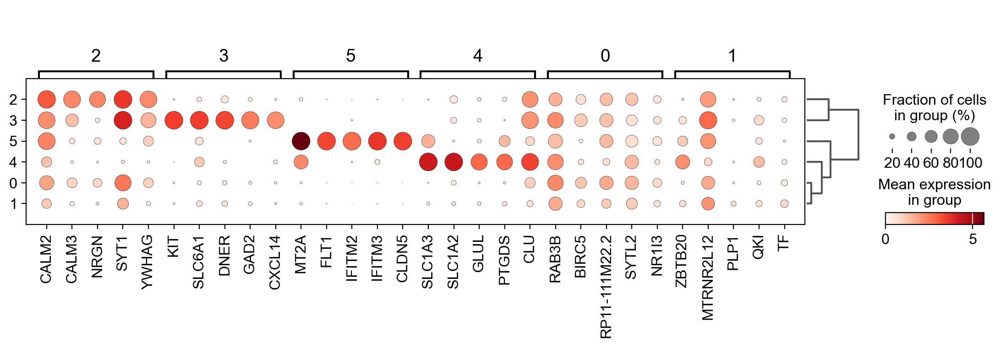

In [53]:
sc.tl.rank_genes_groups(adata_sclerosis, 'clusters', method='wilcoxon')
sc.pl.rank_genes_groups_dotplot(adata_sclerosis, n_genes=5)

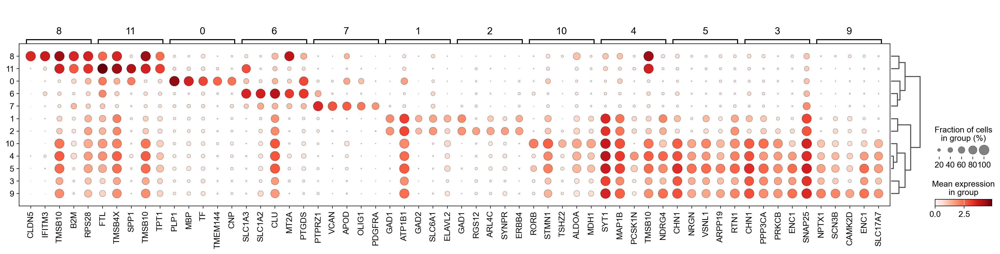

In [54]:
sc.tl.rank_genes_groups(adata_sclerosis_enfermos, 'clusters', method='wilcoxon')
sc.pl.rank_genes_groups_dotplot(adata_sclerosis_enfermos, n_genes=5)

# Clustering, t-SNE & UMAP

Para terminar, mostramos la distribución de los datos usando dos técnicas distintas de reducción de la dimensionalidad, como son t-SNE y UMAP.

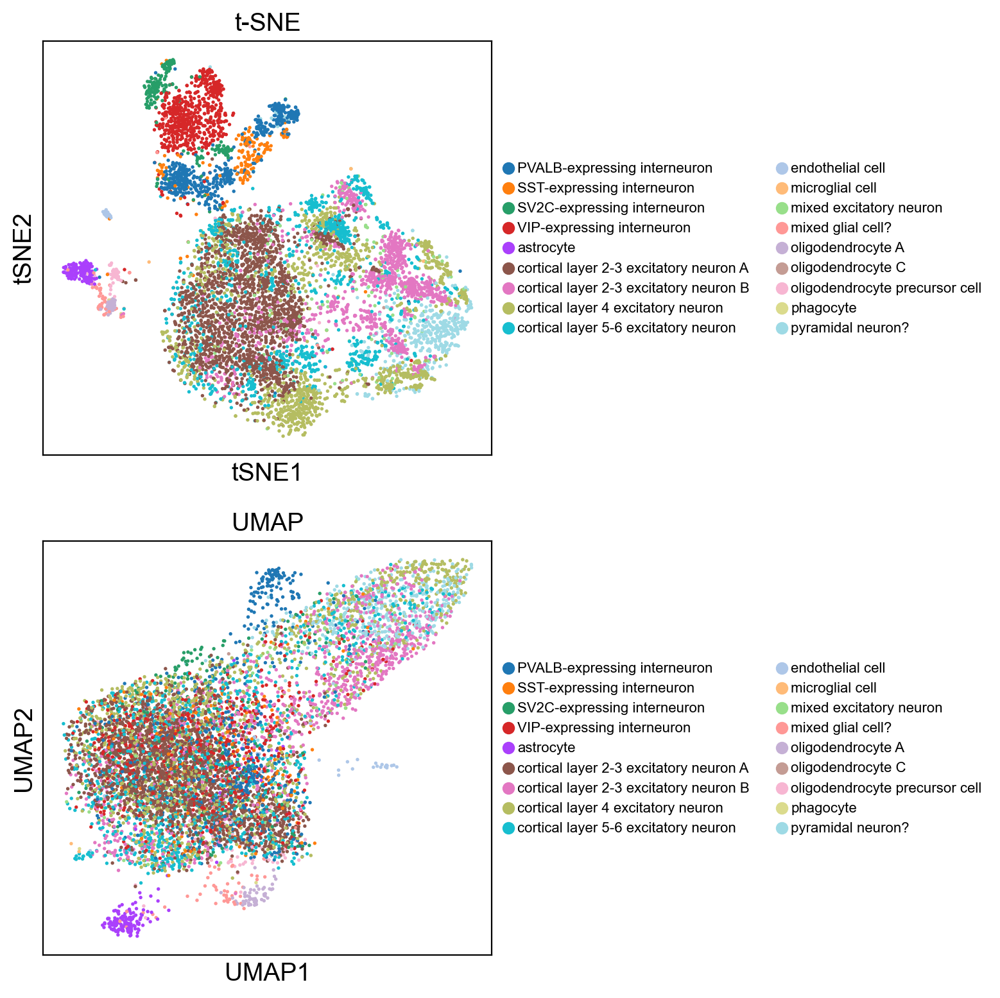

In [ ]:
sc.tl.tsne(adata_sclerosis, use_rep = "X_pca", random_state = 0)

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(8, 8))
sc.pl.tsne(adata_sclerosis, color='celltype', ax=ax1, show=False, title='t-SNE', legend_fontsize=8)
sc.pl.umap(adata_sclerosis, color='celltype', ax=ax2, show=False, title='UMAP', legend_fontsize=8)

plt.tight_layout()
plt.show()

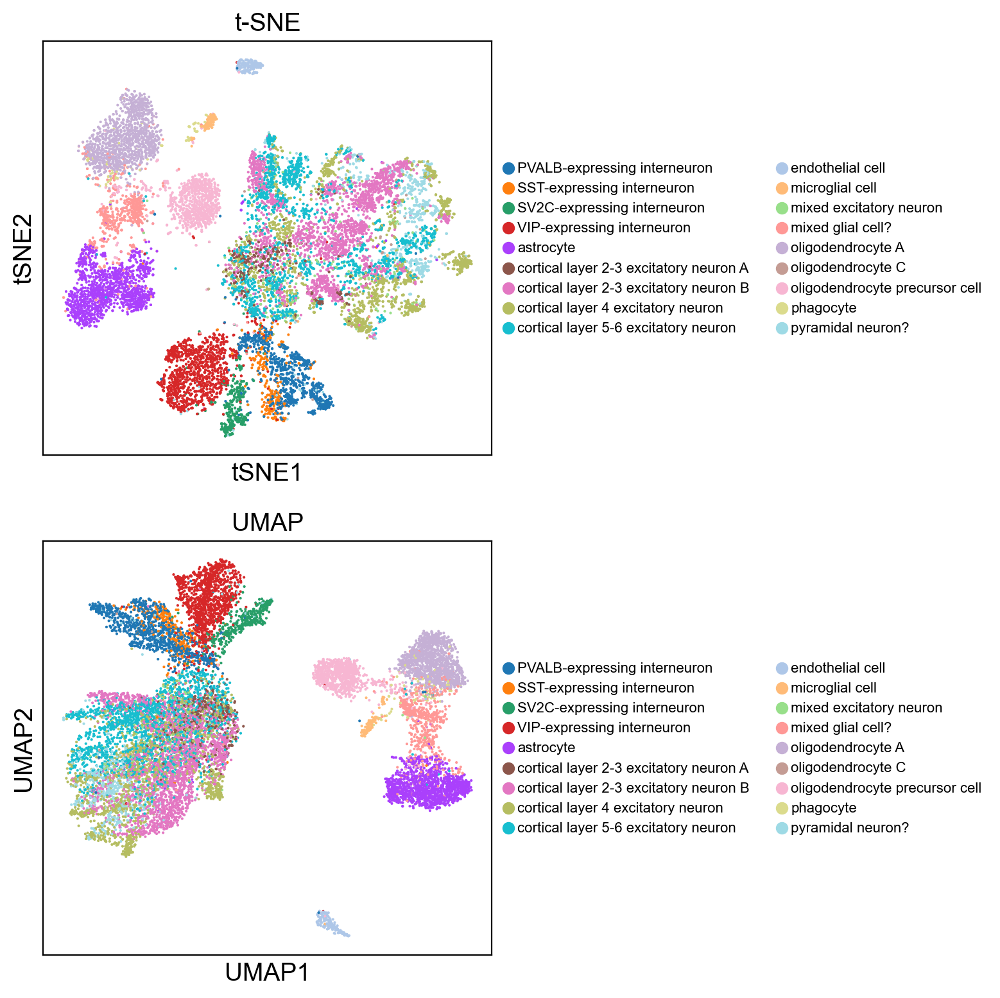

In [ ]:
sc.tl.tsne(adata_sclerosis_enfermos, use_rep = "X_pca", random_state = 0)

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(8, 8))
sc.pl.tsne(adata_sclerosis_enfermos, color='celltype', ax=ax1, show=False, title='t-SNE', legend_fontsize=8)
sc.pl.umap(adata_sclerosis_enfermos, color='celltype', ax=ax2, show=False, title='UMAP', legend_fontsize=8)

plt.tight_layout()
plt.show()

# DATASET Páncreas Yolk Sac

In [ ]:
from sklearn.model_selection import train_test_split
import scanpy as sc
import numpy as np
import anndata as ad
import matplotlib.pyplot as plt
import plotly.express as px

INFO:datasets:PyTorch version 2.5.1 available.
INFO:datasets:TensorFlow version 2.17.0 available.
INFO:datasets:JAX version 0.5.0 available.
INFO:helical:Caduceus not available: If you want to use this model, ensure you have a CUDA GPU and have installed the optional helical[mamba-ssm] dependencies.


In [ ]:
ds = sc.read_h5ad("/Users/doblado/Transformers-Architecture-in-Bioinformatics/Experimentacion/data/17_04_24_YolkSacRaw_F158_WE_annots.h5ad")

train_ids, test_ids = train_test_split(
    np.arange(ds.n_obs), test_size=0.2, random_state=42
)


adata_train = ds[train_ids].copy()
adata_test = ds[test_ids].copy()
sc.pp.normalize_total(adata_train)
sc.pp.log1p(adata_train)

sc.pp.normalize_total(adata_test)
sc.pp.log1p(adata_test)


sc.pp.highly_variable_genes(adata_train, n_top_genes=3000, flavor='seurat_v3', inplace=True)
adata_train = adata_train[:, adata_train.var["highly_variable"]]

sc.pp.highly_variable_genes(adata_test, n_top_genes=3000, flavor='seurat_v3', inplace=True)
adata_test = adata_test[:, adata_test.var["highly_variable"]]

La disponibilidad de metadatos de este conjunto es mucho menor que para los datos de esclerosis múltiple. LVL1, LVL2 y LVL3 hacen referencia a los tres niveles de tipos celulares contenidos en él. Tampoco tenemos información relevante sobre posibles marcadores genéticos, por lo que nuestros análisis variarán un poco.

In [100]:
adata_train.obs.describe()

,component,stage,sex,sort.ids,fetal.ids,orig.dataset,sequencing.type,lanes,LVL1,LVL2,LVL3,LVL3_for_embryo_study
count,25344,25344,25344,25344,25344,25344,25344,25344,25344,25344,25344,25344
unique,2,1,1,1,1,1,1,5,6,27,47,22
top,VA,CS17,Female,Total,F138,WE_YS,5GEX,WS_wEMB12142160,STROMA,ERYTHROID,ERYTHROID,erythroid HBE1+GATA1+
freq,13613,25344,25344,25344,25344,25344,25344,7454,11818,7507,7470,7500


Comenzamos con una visualización de la distribución de los tipos celulares dentro del conjunto de datos, para cada uno de los niveles existentes. Para este conjunto de datos, el balanceo de tipos es aun más desequilibrado que para el conjunto de esclerosis múltiple.

In [6]:
cell_counts = adata_train.obs['LVL1'].value_counts().reset_index()
cell_counts.columns = ['LVL1', 'count']

fig = px.scatter(cell_counts, x = "LVL1", y = "count", color="LVL1",
                 size = 'count',
                 hover_name="LVL1", title = 'Distribución de tipos nivel 1 entrenamiento')
fig.show()

In [7]:
cell_counts = adata_train.obs['LVL2'].value_counts().reset_index()
cell_counts.columns = ['LVL2', 'count']

fig = px.scatter(cell_counts, x = "LVL2", y = "count", color="LVL2",
                 size = 'count',
                 hover_name="LVL2", title = 'Distribución de tipos nivel 2 entrenamiento')
fig.show()

In [9]:
cell_counts = adata_train.obs['LVL3'].value_counts().reset_index()
cell_counts.columns = ['LVL3', 'count']

fig = px.scatter(cell_counts, x = "LVL3", y = "count", color="LVL3",
                 size = 'count',
                 hover_name="LVL3", title = 'Distribución de tipos nivel 3 entrenamiento')
fig.show()

In [3]:
# Datos de entrenamiento
count_instances = ad.AnnData(X = adata_train.X.toarray())
sc.tl.pca(count_instances)
adata_train.obsm["X_pca"] = count_instances.obsm['X_pca']
adata_train.uns["pca"] = count_instances.uns['pca']
adata_train.varm['PCs'] = count_instances.varm['PCs']

sc.pp.neighbors(count_instances, use_rep="X")
sc.tl.umap(count_instances, random_state = 0)

adata_train.obsm["X_umap"] = count_instances.obsm["X_umap"]
adata_train.uns["neighbors"] = count_instances.uns['neighbors']
adata_train.uns["umap"] = count_instances.uns['umap']
adata_train.obsp["distances"] = count_instances.obsp['distances']
adata_train.obsp["connectivities"] = count_instances.obsp['connectivities']

# Datos test
count_instances_test = ad.AnnData(X = adata_test.X.toarray())
sc.tl.pca(count_instances_test)
adata_test.obsm["X_pca"] = count_instances_test.obsm['X_pca']
adata_test.uns["pca"] = count_instances_test.uns['pca']
adata_test.varm['PCs'] = count_instances_test.varm['PCs']

sc.pp.neighbors(count_instances_test, use_rep="X")
sc.tl.umap(count_instances_test, random_state = 0)

adata_test.obsm["X_umap"] = count_instances_test.obsm["X_umap"]
adata_test.uns["neighbors"] = count_instances_test.uns['neighbors']
adata_test.uns["umap"] = count_instances_test.uns['umap']
adata_test.obsp["distances"] = count_instances_test.obsp['distances']
adata_test.obsp["connectivities"] = count_instances_test.obsp['connectivities']

/var/folders/_p/h682dpbs1x55vfnydjml5h_c0000gn/T/ipykernel_1984/445164645.py:4: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata_train.obsm["X_pca"] = count_instances.obsm['X_pca']
/var/folders/_p/h682dpbs1x55vfnydjml5h_c0000gn/T/ipykernel_1984/445164645.py:20: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata_test.obsm["X_pca"] = count_instances_test.obsm['X_pca']


In [102]:
sc.tl.leiden(
    adata_train,
    key_added="clusters",
    resolution=0.5,
    n_iterations=-1,
    flavor="igraph",
    directed=False,
)

In [103]:
sc.tl.leiden(
    adata_test,
    key_added="clusters",
    resolution=0.5,
    n_iterations=-1,
    flavor="igraph",
    directed=False,
)

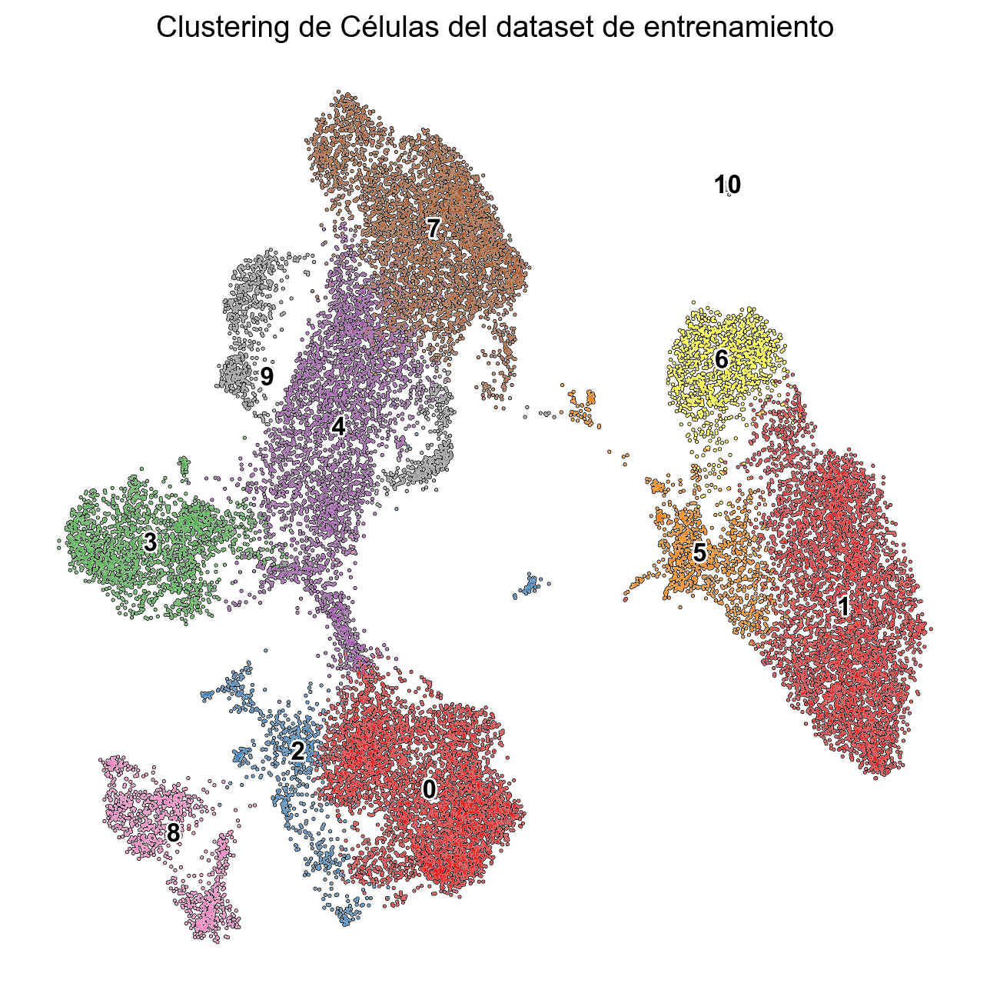

In [ ]:
with rc_context({"figure.figsize": (8, 8)}):
    sc.pl.umap(
        adata_train,
        color="clusters",
        add_outline=True,
        legend_loc="on data",
        legend_fontsize=12,
        legend_fontoutline=2,
        frameon=False,
        title="Clustering de Células del dataset de entrenamiento",
        palette="Set1",
    )

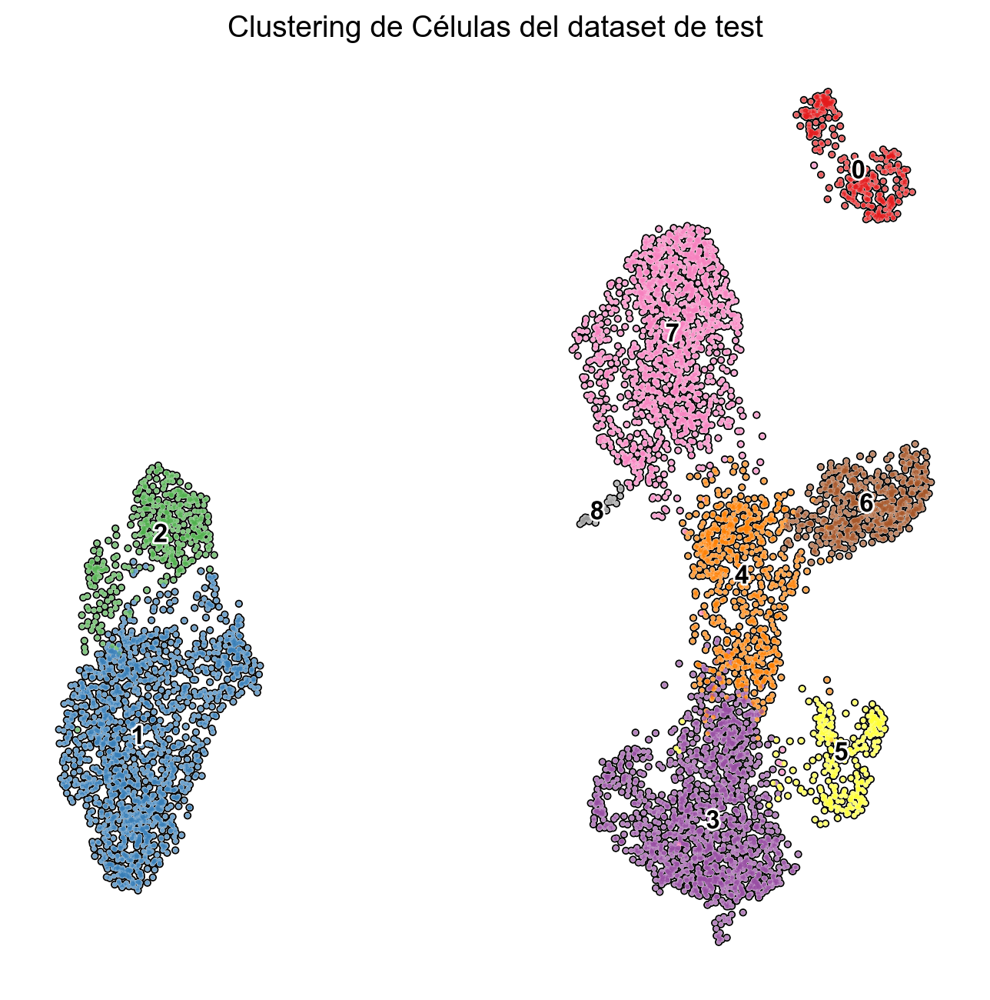

In [108]:
with rc_context({"figure.figsize": (8, 8)}):
    sc.pl.umap(
        adata_test,
        color="clusters",
        add_outline=True,
        legend_loc="on data",
        legend_fontsize=12,
        legend_fontoutline=2,
        frameon=False,
        title="Clustering de Células del dataset de test",
        palette="Set1",
    )

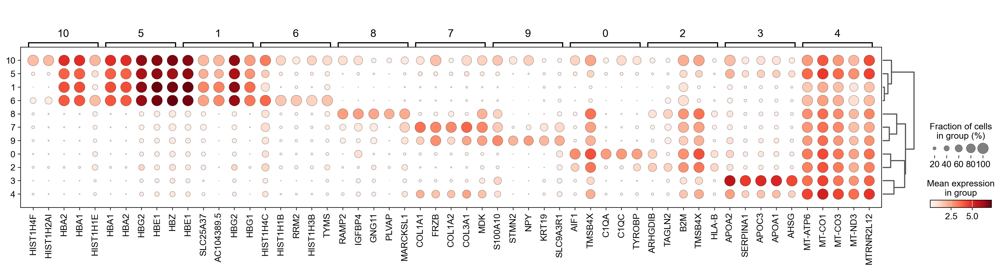

In [111]:
sc.tl.rank_genes_groups(adata_train, 'clusters', method='wilcoxon')
sc.pl.rank_genes_groups_dotplot(adata_train, n_genes=5)

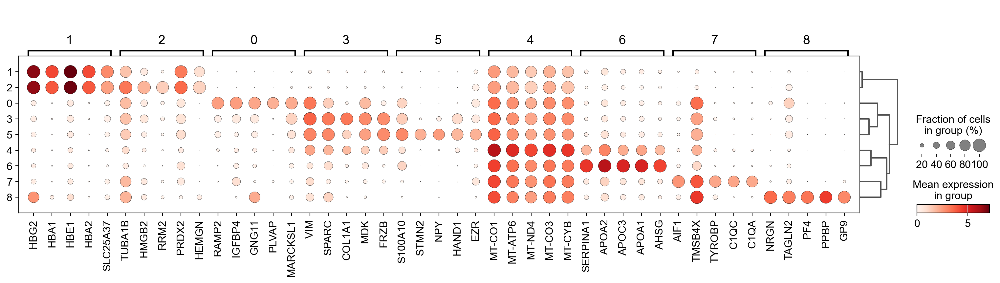

In [112]:
sc.tl.rank_genes_groups(adata_test, 'clusters', method='wilcoxon')
sc.pl.rank_genes_groups_dotplot(adata_test, n_genes=5)

Vamos a observar las representaciones de reducción de dimensionalidad para los tres niveles distintos que nos ofrece el conjunto de datos.

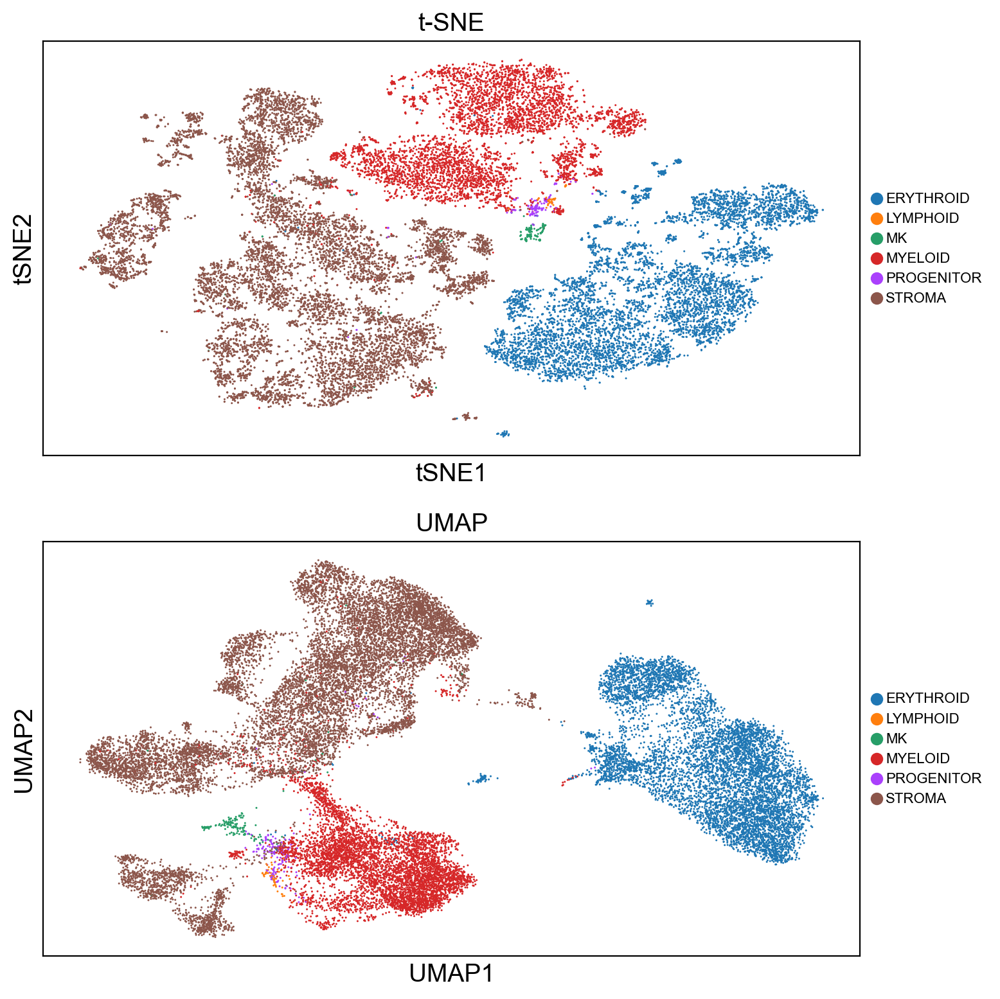

In [116]:
sc.tl.tsne(adata_train, use_rep = "X_pca", random_state = 0)

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(8, 8))
sc.pl.tsne(adata_train, color='LVL1', ax=ax1, show=False, title='t-SNE', legend_fontsize=8)
sc.pl.umap(adata_train, color='LVL1', ax=ax2, show=False, title='UMAP', legend_fontsize=8)

plt.tight_layout()
plt.show()

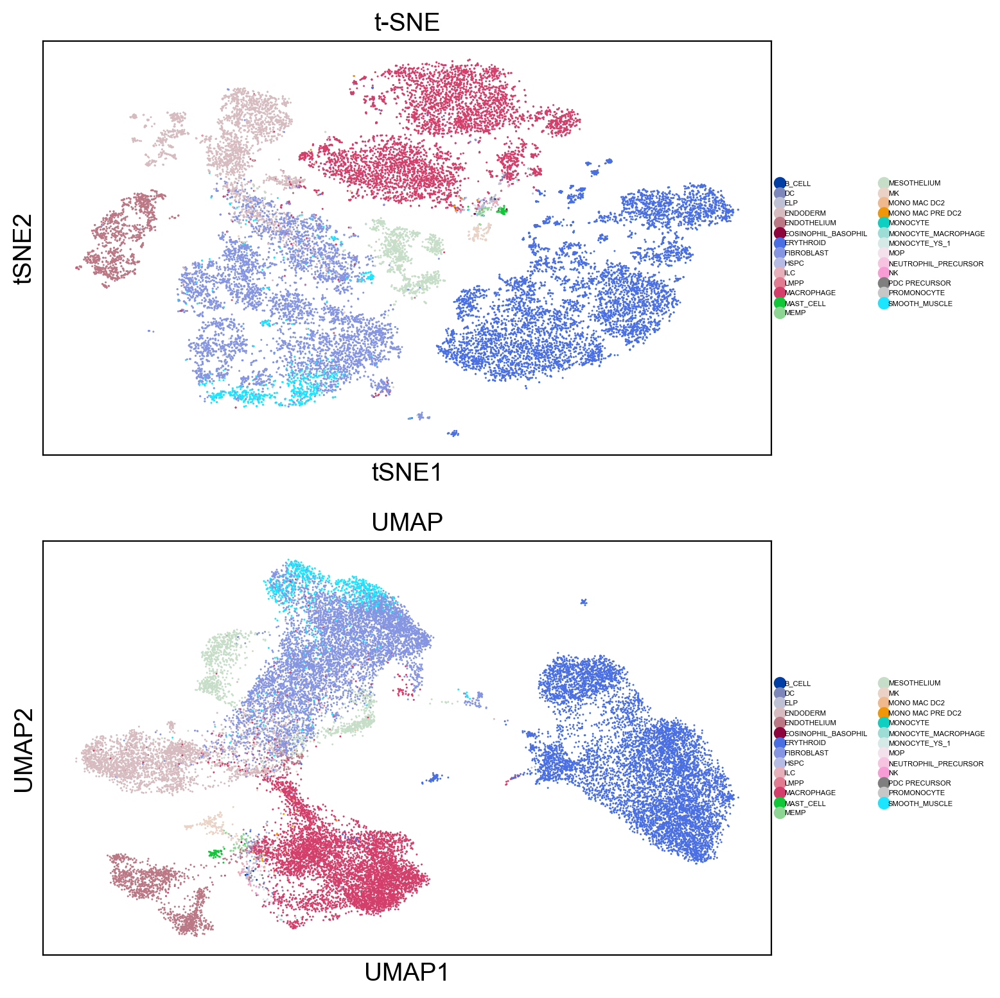

In [ ]:
sc.tl.tsne(adata_train, use_rep = "X_pca", random_state = 0)

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(8, 8))
sc.pl.tsne(adata_train, color='LVL2', ax=ax1, show=False, title='t-SNE', legend_fontsize=6)
sc.pl.umap(adata_train, color='LVL2', ax=ax2, show=False, title='UMAP', legend_fontsize=6)

plt.tight_layout()
plt.show()

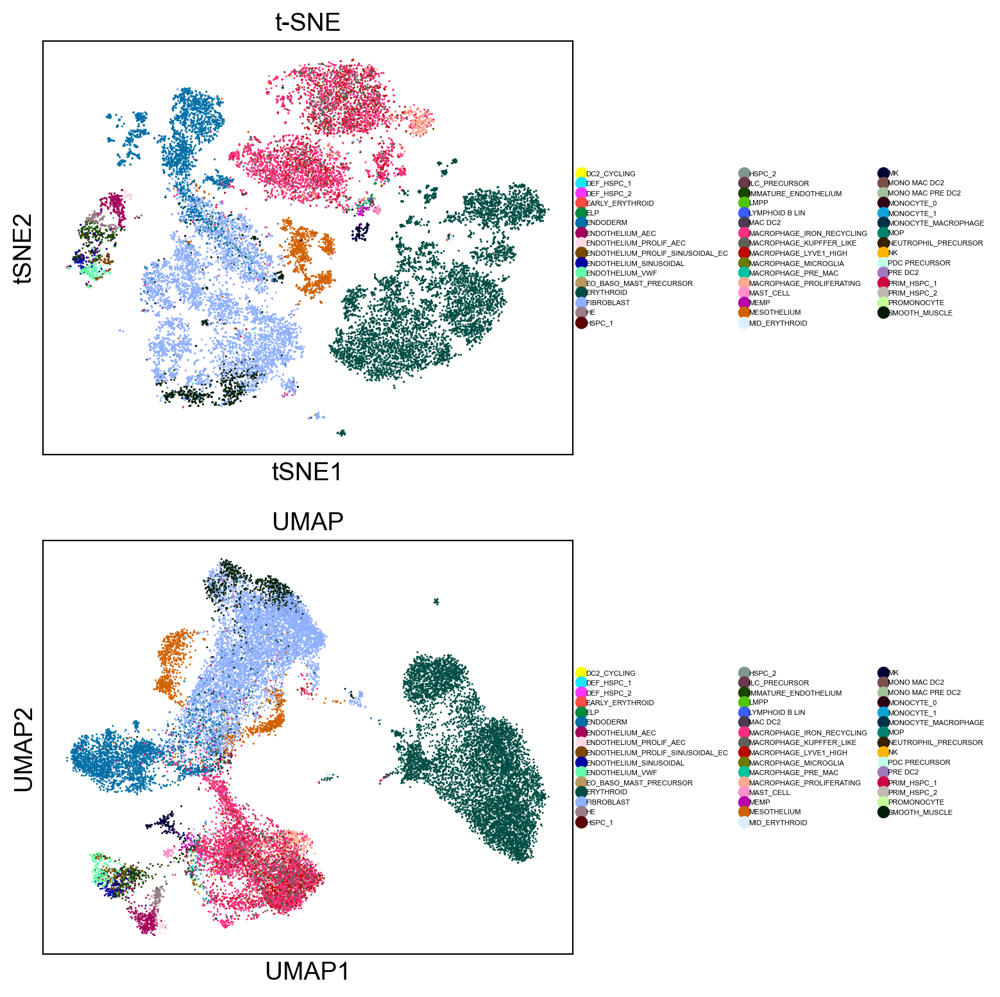

In [114]:
sc.tl.tsne(adata_train, use_rep = "X_pca", random_state = 0)

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(8, 8))
sc.pl.tsne(adata_train, color='LVL3', ax=ax1, show=False, title='t-SNE', legend_fontsize=4)
sc.pl.umap(adata_train, color='LVL3', ax=ax2, show=False, title='UMAP', legend_fontsize=4)

plt.tight_layout()
plt.show()

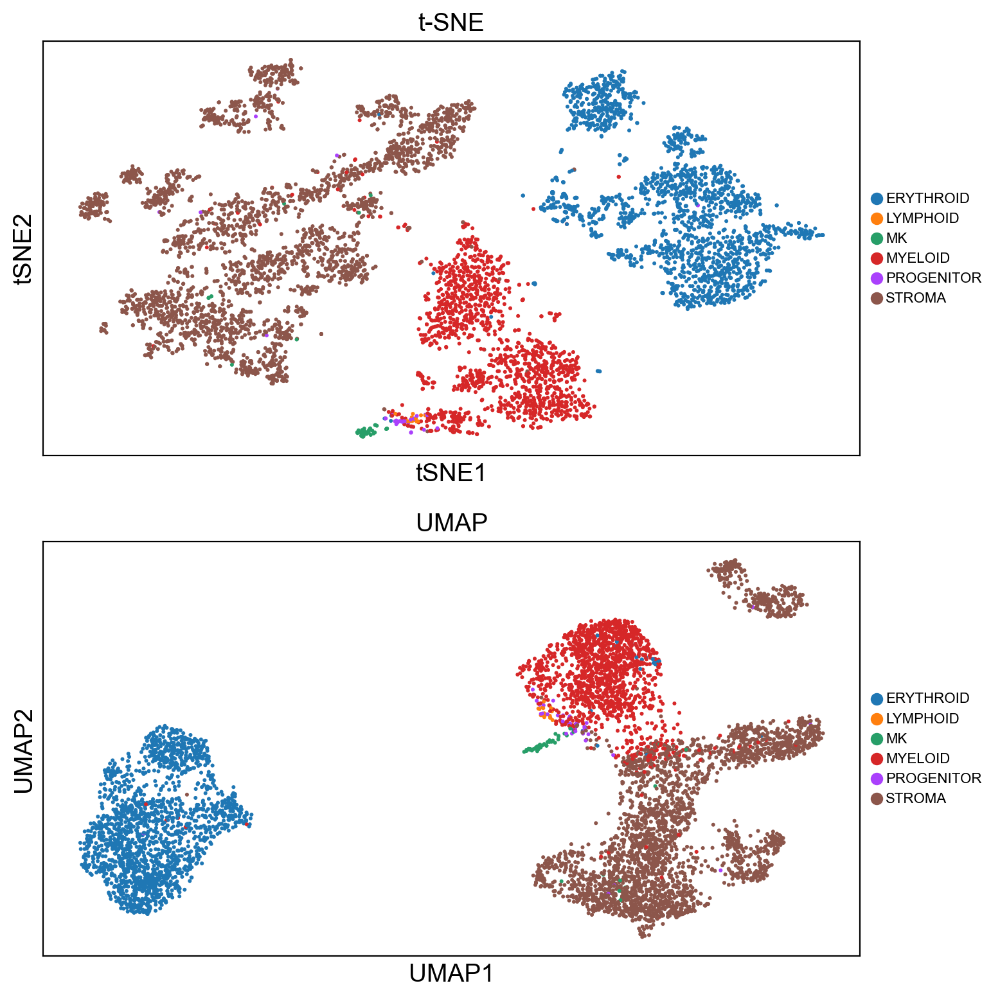

In [117]:
sc.tl.tsne(adata_test, use_rep = "X_pca", random_state = 0)

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(8, 8))
sc.pl.tsne(adata_test, color='LVL1', ax=ax1, show=False, title='t-SNE', legend_fontsize=8)
sc.pl.umap(adata_test, color='LVL1', ax=ax2, show=False, title='UMAP', legend_fontsize=8)

plt.tight_layout()
plt.show()

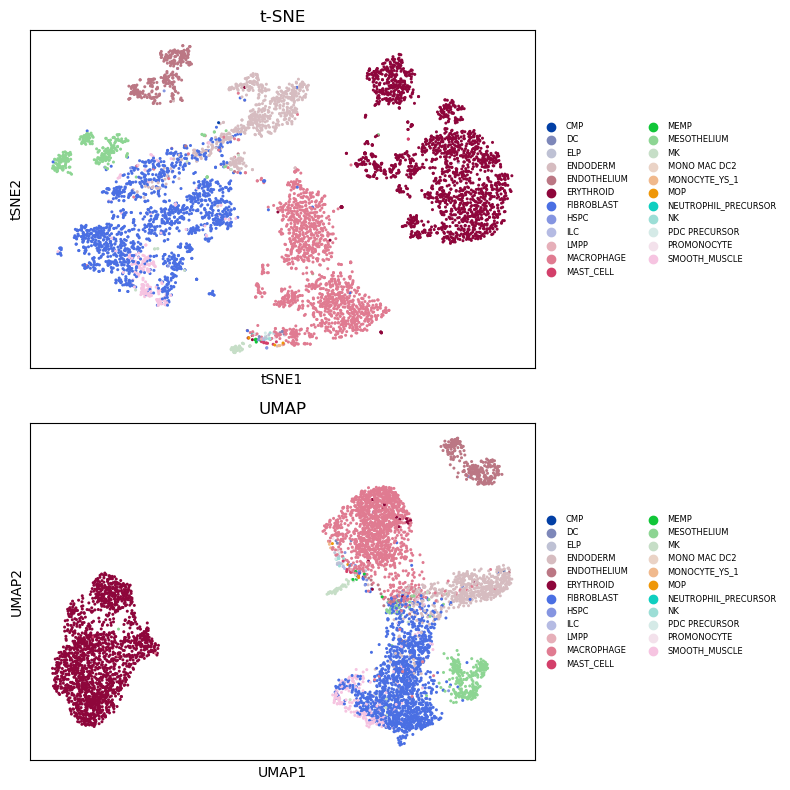

In [6]:
sc.tl.tsne(adata_test, use_rep = "X_pca", random_state = 0)

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(8, 8))
sc.pl.tsne(adata_test, color='LVL2', ax=ax1, show=False, title='t-SNE', legend_fontsize=6)
sc.pl.umap(adata_test, color='LVL2', ax=ax2, show=False, title='UMAP', legend_fontsize=6)

plt.tight_layout()
plt.show()

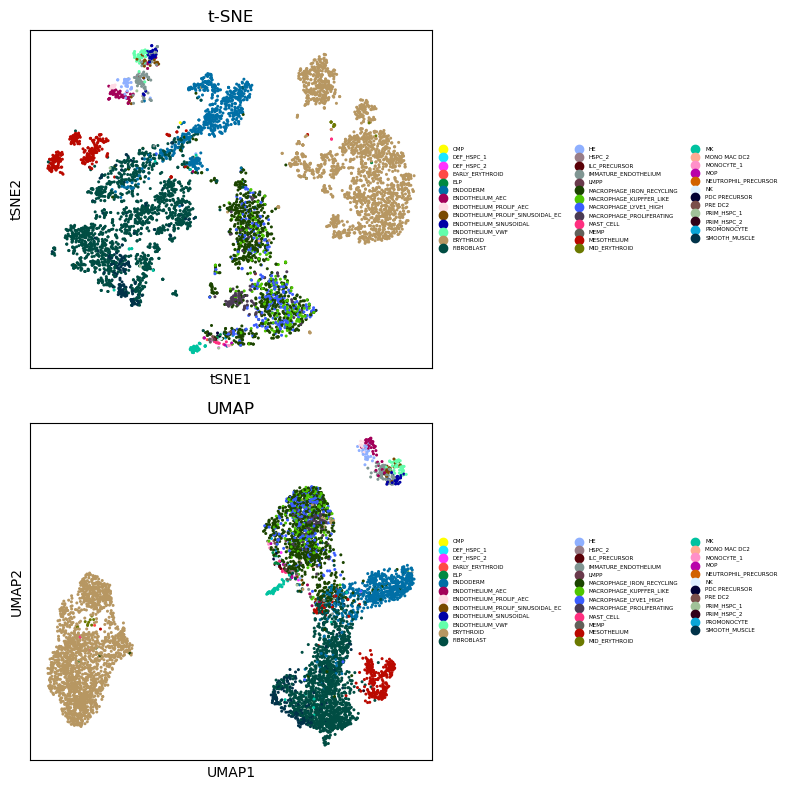

In [7]:
sc.tl.tsne(adata_test, use_rep = "X_pca", random_state = 0)

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(8, 8))
sc.pl.tsne(adata_test, color='LVL3', ax=ax1, show=False, title='t-SNE', legend_fontsize=4)
sc.pl.umap(adata_test, color='LVL3', ax=ax2, show=False, title='UMAP', legend_fontsize=4)

plt.tight_layout()
plt.show()